- Module Code: CS3PP19
- Assignment report Title: Summative Coursework 
- Student Number: 27022524
- Date(when the work completed): 5/12/2020
- Actual hrs spent for the assignment: 30 
- Assignment evaluation (3 key points):
    - One thing that I would change about this assignment would be to allow for a wider selection visualisation libraries to be used. 
    - Datasets could be smaller as running some functions slows down or glitches report. 
    - Learn more python functions and how to apply them in different situaitons. Would have solved problems within report. 

## Task 1 – Bike journey exploratory data analysis

### Task 1.1 - Load the metro.csv file into the pandas dataframe

In [574]:
import pandas as pd  
import numpy as np
import seaborn as sns
%matplotlib inline 
import matplotlib.pyplot as plt 
import matplotlib as mpl

import seaborn as sns; sns.set()

import sklearn
from sklearn import preprocessing
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import scale

import sklearn.metrics as sm
from sklearn import datasets


#Importing all the libraries needed

In [575]:
import sys
data = pd.read_csv('~/Desktop/metro.csv')  

#Importing the metro.csv file into the pandas framework with the pd.read_csv function


/Users/yusuffazaldin/opt/anaconda3/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3071: DtypeWarning: Columns (10) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [576]:
data  
#This function gives a preview of the first and last few data rows in the csv file. 
#It also declares how many rows * columns there are.

,trip_id,duration,start_time,end_time,start_station,start_lat,start_lon,end_station,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
0,124657107,5,7/1/2019 0:04,7/1/2019 0:09,4312,34.066990,-118.290878,4410,34.063351,-118.296799,6168,30,One Way,Monthly Pass,standard
1,124657587,9,7/1/2019 0:07,7/1/2019 0:16,3066,34.063389,-118.236160,3066,34.063389,-118.236160,17584,30,Round Trip,Monthly Pass,electric
2,124658068,5,7/1/2019 0:20,7/1/2019 0:25,4410,34.063351,-118.296799,4312,34.066990,-118.290878,18920,30,One Way,Monthly Pass,electric
3,124659747,20,7/1/2019 0:44,7/1/2019 1:04,3045,34.028511,-118.256668,4275,34.012520,-118.285896,6016,1,One Way,Walk-up,standard
4,124660227,27,7/1/2019 0:44,7/1/2019 1:11,3035,34.048401,-118.260948,3049,34.056969,-118.253593,5867,30,One Way,Monthly Pass,standard
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92119,130053092,8,9/30/2019 23:32,9/30/2019 23:40,3038,34.046822,-118.248352,3078,34.064281,-118.238937,19655,1,One Way,Walk-up,electric
92120,130053090,15,9/30/2019 23:38,9/30/2019 23:53,4401,34.075611,-118.291862,4401,34.075611,-118.291862,18984,30,Round Trip,Monthly Pass,electric
92121,130053089,1,9/30/2019 23:40,9/30/2019 23:41,3038,34.046822,-118.248352,3067,34.045181,-118.250237,12361,365,One Way,Annual Pass,standard
92122,130053088,22,9/30/2019 23:41,10/1/2019 0:03,3067,34.045181,-118.250237,3049,34.056969,-118.253593,16580,365,One Way,Annual Pass,electric


In [577]:
data.head()  

# Reading first 5 lines of data to get a preview of the set

,trip_id,duration,start_time,end_time,start_station,start_lat,start_lon,end_station,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
0,124657107,5,7/1/2019 0:04,7/1/2019 0:09,4312,34.066990,-118.290878,4410,34.063351,-118.296799,6168,30,One Way,Monthly Pass,standard
1,124657587,9,7/1/2019 0:07,7/1/2019 0:16,3066,34.063389,-118.236160,3066,34.063389,-118.236160,17584,30,Round Trip,Monthly Pass,electric
2,124658068,5,7/1/2019 0:20,7/1/2019 0:25,4410,34.063351,-118.296799,4312,34.066990,-118.290878,18920,30,One Way,Monthly Pass,electric
3,124659747,20,7/1/2019 0:44,7/1/2019 1:04,3045,34.028511,-118.256668,4275,34.012520,-118.285896,6016,1,One Way,Walk-up,standard
4,124660227,27,7/1/2019 0:44,7/1/2019 1:11,3035,34.048401,-118.260948,3049,34.056969,-118.253593,5867,30,One Way,Monthly Pass,standard


In [578]:
data.tail()

# Reading last 5 rows of data
# From this, saw what the missing data values are and their corresponding columns.

,trip_id,duration,start_time,end_time,start_station,start_lat,start_lon,end_station,end_lat,end_lon,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
92119,130053092,8,9/30/2019 23:32,9/30/2019 23:40,3038,34.046822,-118.248352,3078,34.064281,-118.238937,19655,1,One Way,Walk-up,electric
92120,130053090,15,9/30/2019 23:38,9/30/2019 23:53,4401,34.075611,-118.291862,4401,34.075611,-118.291862,18984,30,Round Trip,Monthly Pass,electric
92121,130053089,1,9/30/2019 23:40,9/30/2019 23:41,3038,34.046822,-118.248352,3067,34.045181,-118.250237,12361,365,One Way,Annual Pass,standard
92122,130053088,22,9/30/2019 23:41,10/1/2019 0:03,3067,34.045181,-118.250237,3049,34.056969,-118.253593,16580,365,One Way,Annual Pass,electric
92123,130053087,4,9/30/2019 23:58,10/1/2019 0:02,4417,34.164951,-118.363632,4285,NaN,NaN,15727,365,One Way,Walk-up,smart


In [579]:
data.describe()

#returns statistics about the numerical columns in a dataset


,trip_id,duration,start_station,start_lat,start_lon,end_station,end_lat,end_lon,plan_duration
count,9.212400e+04,92124.000000,92124.000000,89985.000000,89985.000000,92124.000000,88052.000000,88052.000000,92124.000000
mean,1.274286e+08,33.168588,3484.899690,34.034786,-118.287893,3480.271026,34.034895,-118.286699,60.290977
std,1.524134e+06,129.057841,611.483883,0.058803,0.073501,609.942741,0.058790,0.072628,111.141364
min,1.246571e+08,1.000000,3000.000000,33.710979,-118.495422,3000.000000,33.710979,-118.495422,1.000000
25%,1.261375e+08,6.000000,3029.000000,34.035801,-118.281181,3028.000000,34.037048,-118.280952,1.000000
50%,1.274911e+08,12.000000,3062.000000,34.046810,-118.258537,3062.000000,34.046810,-118.258537,30.000000
75%,1.287379e+08,22.000000,4285.000000,34.051941,-118.248253,4285.000000,34.051941,-118.248253,30.000000
max,1.303877e+08,1440.000000,4453.000000,34.177662,-118.231277,4453.000000,34.177662,-118.231277,999.000000


In [580]:
data.columns 
# Name of all the columns in the dataset

Index(['trip_id', 'duration', 'start_time', 'end_time', 'start_station',
       'start_lat', 'start_lon', 'end_station', 'end_lat', 'end_lon',
       'bike_id', 'plan_duration', 'trip_route_category', 'passholder_type',
       'bike_type'],
      dtype='object')

In [581]:
data.nunique()
# how many values per column name

trip_id                92124
duration                 857
start_time             57274
end_time               55658
start_station            183
start_lat                180
start_lon                179
end_station              183
end_lat                  180
end_lon                  179
bike_id                 3564
plan_duration              4
trip_route_category        2
passholder_type            6
bike_type                  3
dtype: int64

###  Task 1.2 - Find a sensible way to remove the missing values from the data frame and explain why you have chosen this method.

In [582]:
#check for null values in dataset, although earlier we saw samples of the data, it is inefficient to view 
#all n number of rows. By using isnull function, columns with null data will show here incase any of the null 
#categories are missed

data.isnull().sum()

trip_id                   0
duration                  0
start_time                0
end_time                  0
start_station             0
start_lat              2139
start_lon              2139
end_station               0
end_lat                4072
end_lon                4072
bike_id                   0
plan_duration             0
trip_route_category       0
passholder_type           0
bike_type                 0
dtype: int64

In [583]:
data.drop(['start_lat', 'start_lon', 'end_lat', 'end_lon'], axis=1, inplace = True)

# Drop function is used here because it allows for all columns to be declared and removed in one step. 
# Axis = 1 in this function points to the column label axis so that the right columns can be removed.
 

In [584]:
data.tail() 

# Columns not longer showing with null data 

,trip_id,duration,start_time,end_time,start_station,end_station,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
92119,130053092,8,9/30/2019 23:32,9/30/2019 23:40,3038,3078,19655,1,One Way,Walk-up,electric
92120,130053090,15,9/30/2019 23:38,9/30/2019 23:53,4401,4401,18984,30,Round Trip,Monthly Pass,electric
92121,130053089,1,9/30/2019 23:40,9/30/2019 23:41,3038,3067,12361,365,One Way,Annual Pass,standard
92122,130053088,22,9/30/2019 23:41,10/1/2019 0:03,3067,3049,16580,365,One Way,Annual Pass,electric
92123,130053087,4,9/30/2019 23:58,10/1/2019 0:02,4417,4285,15727,365,One Way,Walk-up,smart


In [585]:
data.isnull().sum()

# double checking to see if there is still any null data in dataframe

trip_id                0
duration               0
start_time             0
end_time               0
start_station          0
end_station            0
bike_id                0
plan_duration          0
trip_route_category    0
passholder_type        0
bike_type              0
dtype: int64

### Task 1.3 - Explore the distribution of the duration variable. You should produce a plotvisualising the distribution and calculate and briefly discuss statistics of the variable.

**Visualisation**

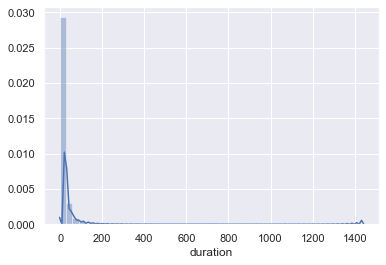

In [586]:
sns.distplot(data['duration']) 

 *Figure 1*

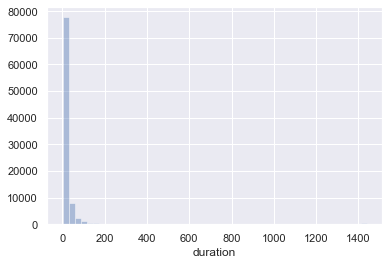

In [587]:
sns.distplot(data['duration'], kde = False) 

#As a single variable is being examined, a histogram represents this distribution of the duration.

*Figure 2*

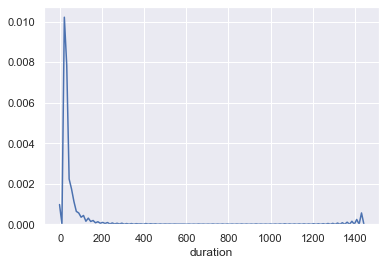

In [588]:
sns.distplot(data['duration'],hist = False) 

*Figure 3*

**Statistics**

In [589]:
data[['duration']].describe()

,duration
count,92124.000000
mean,33.168588
std,129.057841
min,1.000000
25%,6.000000
50%,12.000000
75%,22.000000
max,1440.000000


In [590]:
data.duration


0         5
1         9
2         5
3        20
4        27
         ..
92119     8
92120    15
92121     1
92122    22
92123     4
Name: duration, Length: 92124, dtype: int64

**Analysis**

By looking at the statistics of this data we can see that across all the data (92,124 datapoints) 
the mean journey time was 33 minutes (nearest whole number). The longest bike journey recorded was 
17.4 hours and the shortest was 1 minute. Furthermore, we can see the standard deviation is 129 which 
shows the variability of this data in comparison to the mean. Overall, the data in this sample is 
quite spread in its min and max values however, when looking at the values for the 25th and 75th quartile and compare it to the mean, there are several long journey outliers. This is due to the mean of 33 minutes
being higher than the 75th quartile (75% of journeys were less than 22 minutes compared to the mean of 33).

###  Task 1.4 -  Produce a plot showing how the distribution of duration relates to passholder_type.

**Visualisation**

 - Graphs used are based on comparing continuous data with categorical

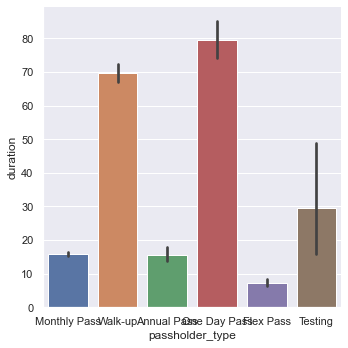

In [592]:
sns.catplot(x='passholder_type', y='duration', data=data, kind="bar")

<function IPython.core.display.display(*objs, include=None, exclude=None, metadata=None, transient=None, display_id=None, **kwargs)>

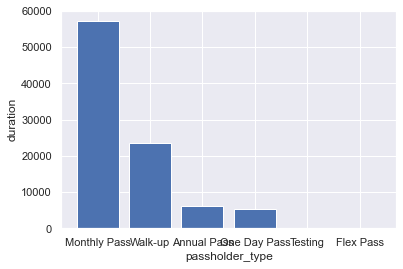

In [593]:
cc = data['passholder_type'].value_counts()
plt.bar(cc.index,cc)
plt.xlabel('passholder_type')
plt.ylabel('duration')
display

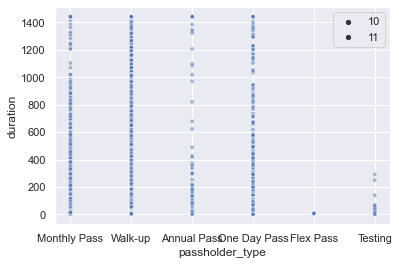

In [594]:
sns.scatterplot( x='passholder_type', y='duration', data=data,alpha=0.5, size=11)

###  Task 1.5 - Convert the start_time and end_time columns to date objects if they are not already.

In [595]:
data.dtypes  # Checking current data types of all columns

trip_id                 int64
duration                int64
start_time             object
end_time               object
start_station           int64
end_station             int64
bike_id                object
plan_duration           int64
trip_route_category    object
passholder_type        object
bike_type              object
dtype: object

In [596]:
data.head()


,trip_id,duration,start_time,end_time,start_station,end_station,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
0,124657107,5,7/1/2019 0:04,7/1/2019 0:09,4312,4410,6168,30,One Way,Monthly Pass,standard
1,124657587,9,7/1/2019 0:07,7/1/2019 0:16,3066,3066,17584,30,Round Trip,Monthly Pass,electric
2,124658068,5,7/1/2019 0:20,7/1/2019 0:25,4410,4312,18920,30,One Way,Monthly Pass,electric
3,124659747,20,7/1/2019 0:44,7/1/2019 1:04,3045,4275,6016,1,One Way,Walk-up,standard
4,124660227,27,7/1/2019 0:44,7/1/2019 1:11,3035,3049,5867,30,One Way,Monthly Pass,standard


In [597]:
data['start_time'] = pd.to_datetime(data.start_time) 

#function to convert column 'start_time' to datetime format within the pandas library

In [598]:
data.head()

,trip_id,duration,start_time,end_time,start_station,end_station,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
0,124657107,5,2019-07-01 00:04:00,7/1/2019 0:09,4312,4410,6168,30,One Way,Monthly Pass,standard
1,124657587,9,2019-07-01 00:07:00,7/1/2019 0:16,3066,3066,17584,30,Round Trip,Monthly Pass,electric
2,124658068,5,2019-07-01 00:20:00,7/1/2019 0:25,4410,4312,18920,30,One Way,Monthly Pass,electric
3,124659747,20,2019-07-01 00:44:00,7/1/2019 1:04,3045,4275,6016,1,One Way,Walk-up,standard
4,124660227,27,2019-07-01 00:44:00,7/1/2019 1:11,3035,3049,5867,30,One Way,Monthly Pass,standard


In [599]:
data.dtypes

trip_id                         int64
duration                        int64
start_time             datetime64[ns]
end_time                       object
start_station                   int64
end_station                     int64
bike_id                        object
plan_duration                   int64
trip_route_category            object
passholder_type                object
bike_type                      object
dtype: object

In [600]:
data['end_time'] = pd.to_datetime(data.end_time)  

# repeating same function with end_time column

In [601]:
data.dtypes

trip_id                         int64
duration                        int64
start_time             datetime64[ns]
end_time               datetime64[ns]
start_station                   int64
end_station                     int64
bike_id                        object
plan_duration                   int64
trip_route_category            object
passholder_type                object
bike_type                      object
dtype: object

In [602]:
data.tail()

,trip_id,duration,start_time,end_time,start_station,end_station,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
92119,130053092,8,2019-09-30 23:32:00,2019-09-30 23:40:00,3038,3078,19655,1,One Way,Walk-up,electric
92120,130053090,15,2019-09-30 23:38:00,2019-09-30 23:53:00,4401,4401,18984,30,Round Trip,Monthly Pass,electric
92121,130053089,1,2019-09-30 23:40:00,2019-09-30 23:41:00,3038,3067,12361,365,One Way,Annual Pass,standard
92122,130053088,22,2019-09-30 23:41:00,2019-10-01 00:03:00,3067,3049,16580,365,One Way,Annual Pass,electric
92123,130053087,4,2019-09-30 23:58:00,2019-10-01 00:02:00,4417,4285,15727,365,One Way,Walk-up,smart


In [603]:
data.info()  

#More detailed information about columns in dataframe

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 92124 entries, 0 to 92123
Data columns (total 11 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   trip_id              92124 non-null  int64         
 1   duration             92124 non-null  int64         
 2   start_time           92124 non-null  datetime64[ns]
 3   end_time             92124 non-null  datetime64[ns]
 4   start_station        92124 non-null  int64         
 5   end_station          92124 non-null  int64         
 6   bike_id              92124 non-null  object        
 7   plan_duration        92124 non-null  int64         
 8   trip_route_category  92124 non-null  object        
 9   passholder_type      92124 non-null  object        
 10  bike_type            92124 non-null  object        
dtypes: datetime64[ns](2), int64(5), object(4)
memory usage: 7.7+ MB


### Task 1.6 - Create a new column in the data that gives the hour of the day that each journey started on.

In [604]:
data['start_time'].dt.hour   #function to pull starting hour from the date time format

0         0
1         0
2         0
3         0
4         0
         ..
92119    23
92120    23
92121    23
92122    23
92123    23
Name: start_time, Length: 92124, dtype: int64

In [605]:
data.head()

,trip_id,duration,start_time,end_time,start_station,end_station,bike_id,plan_duration,trip_route_category,passholder_type,bike_type
0,124657107,5,2019-07-01 00:04:00,2019-07-01 00:09:00,4312,4410,6168,30,One Way,Monthly Pass,standard
1,124657587,9,2019-07-01 00:07:00,2019-07-01 00:16:00,3066,3066,17584,30,Round Trip,Monthly Pass,electric
2,124658068,5,2019-07-01 00:20:00,2019-07-01 00:25:00,4410,4312,18920,30,One Way,Monthly Pass,electric
3,124659747,20,2019-07-01 00:44:00,2019-07-01 01:04:00,3045,4275,6016,1,One Way,Walk-up,standard
4,124660227,27,2019-07-01 00:44:00,2019-07-01 01:11:00,3035,3049,5867,30,One Way,Monthly Pass,standard


In [606]:
data['startingHour'] = data['start_time'].dt.hour 

#creating column called starting hour and assigning it the function that pulls hour from the datetime format.


In [607]:
data.head()

,trip_id,duration,start_time,end_time,start_station,end_station,bike_id,plan_duration,trip_route_category,passholder_type,bike_type,startingHour
0,124657107,5,2019-07-01 00:04:00,2019-07-01 00:09:00,4312,4410,6168,30,One Way,Monthly Pass,standard,0
1,124657587,9,2019-07-01 00:07:00,2019-07-01 00:16:00,3066,3066,17584,30,Round Trip,Monthly Pass,electric,0
2,124658068,5,2019-07-01 00:20:00,2019-07-01 00:25:00,4410,4312,18920,30,One Way,Monthly Pass,electric,0
3,124659747,20,2019-07-01 00:44:00,2019-07-01 01:04:00,3045,4275,6016,1,One Way,Walk-up,standard,0
4,124660227,27,2019-07-01 00:44:00,2019-07-01 01:11:00,3035,3049,5867,30,One Way,Monthly Pass,standard,0


### Task 1.7 - Explore how the duration variable varies between each journey starting hour of the day, creating a plot to visualise this.  

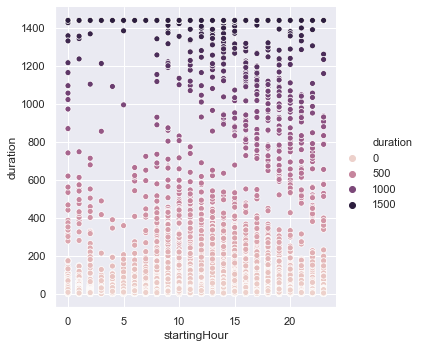

In [608]:
sns.relplot(x = 'startingHour', y = 'duration', hue = 'duration', data=data)


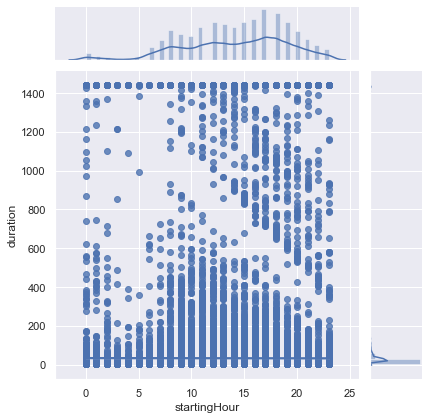

In [640]:
sns.jointplot(x= 'startingHour' ,y='duration',data=data, kind='reg')


### Task 1.8 - Distribution of bike types

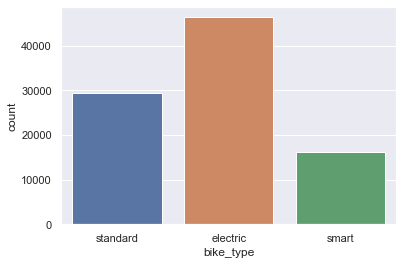

In [610]:
sns.countplot(x='bike_type' , data=data)

**Analysis**

By looking at the bar chart is it evident that across the whole sample size,that the electric bike type is the most popular.

### Task 1.9 - Plots showing the distribution of the duration variable when compared to day of the week and bike type and discuss the results.

**Visualisation**

In [611]:
data['day'] = data.start_time.dt.day_name() 

# Adding new day column by splitting and analysing the starting time date format.
# The day_name() function returns day name


In [612]:
data.head()

,trip_id,duration,start_time,end_time,start_station,end_station,bike_id,plan_duration,trip_route_category,passholder_type,bike_type,startingHour,day
0,124657107,5,2019-07-01 00:04:00,2019-07-01 00:09:00,4312,4410,6168,30,One Way,Monthly Pass,standard,0,Monday
1,124657587,9,2019-07-01 00:07:00,2019-07-01 00:16:00,3066,3066,17584,30,Round Trip,Monthly Pass,electric,0,Monday
2,124658068,5,2019-07-01 00:20:00,2019-07-01 00:25:00,4410,4312,18920,30,One Way,Monthly Pass,electric,0,Monday
3,124659747,20,2019-07-01 00:44:00,2019-07-01 01:04:00,3045,4275,6016,1,One Way,Walk-up,standard,0,Monday
4,124660227,27,2019-07-01 00:44:00,2019-07-01 01:11:00,3035,3049,5867,30,One Way,Monthly Pass,standard,0,Monday


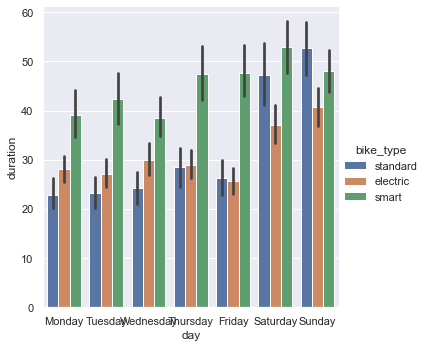

In [613]:
sns.catplot(x='day', y='duration', hue='bike_type', data=data,kind="bar") 

#used catplot function as comparing 2 categorical variables with a continuous. 

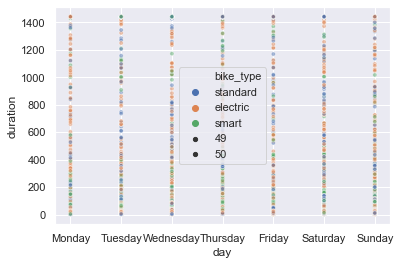

In [642]:
sns.scatterplot(x='day', y='duration', hue='bike_type', data=data, alpha = 0.5 ,size = 50)

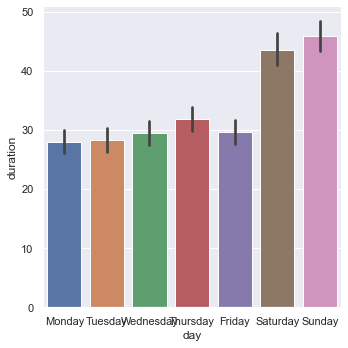

In [643]:
sns.catplot(x='day', y='duration', data = data, kind = 'bar')

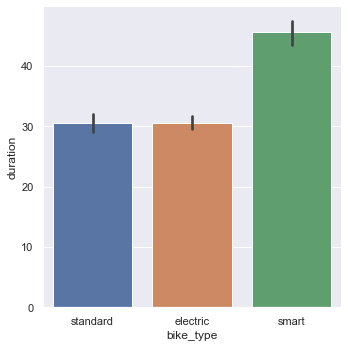

In [645]:
sns.catplot(x='bike_type', y='duration', data = data, kind = 'bar')

**Analysis**

Overall from all the plots, it is evident that the most used type of bike was the smart bike across all days
except Sunday. The second most used type was the electric bike and last standard. This is due to the longer journeys mainly being done with smart of electric bikes. 


### Task 1.10 - The total number of passholders of each type travelling on each day

In [615]:
pd.DataFrame(data.passholder_type.value_counts())  

# View the subcategories of a column passholder_type

,passholder_type
Monthly Pass,57175
Walk-up,23502
Annual Pass,6220
One Day Pass,5175
Testing,46
Flex Pass,6


In [616]:
pd.DataFrame(data.day.value_counts())

# Checking number of journeys per day

,day
Tuesday,14278
Thursday,13922
Monday,13887
Friday,13777
Wednesday,13612
Sunday,11453
Saturday,11195


In [618]:
bypassholder = data.groupby("passholder_type").day.value_counts()

# new variable that groups passholder_type with total number of journeys per day. This gives the total number of 
# journeys made by a certain passholder on a certain day. 

In [619]:
bypassholder

passholder_type  day      
Annual Pass      Wednesday    1082
                 Tuesday      1081
                 Monday       1046
                 Friday        994
                 Thursday      976
                 Saturday      560
                 Sunday        481
Flex Pass        Thursday        4
                 Friday          1
                 Monday          1
Monthly Pass     Tuesday      9570
                 Monday       9322
                 Wednesday    9099
                 Thursday     8999
                 Friday       8676
                 Sunday       5906
                 Saturday     5603
One Day Pass     Sunday       1054
                 Saturday     1029
                 Friday        765
                 Thursday      669
                 Wednesday     579
                 Tuesday       557
                 Monday        522
Testing          Sunday         12
                 Thursday        7
                 Saturday        6
                 Wednesday  

In [620]:
bypassholder.unstack()  

# view the data in a table form for ease of visualisation

day,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday
passholder_type,,,,,,,
Annual Pass,994.0,1046.0,560.0,481.0,976.0,1081.0,1082.0
Flex Pass,1.0,1.0,NaN,NaN,4.0,NaN,NaN
Monthly Pass,8676.0,9322.0,5603.0,5906.0,8999.0,9570.0,9099.0
One Day Pass,765.0,522.0,1029.0,1054.0,669.0,557.0,579.0
Testing,5.0,5.0,6.0,12.0,7.0,5.0,6.0
Walk-up,3336.0,2991.0,3997.0,4000.0,3267.0,3065.0,2846.0


In [621]:
heatpassholder = bypassholder.unstack()

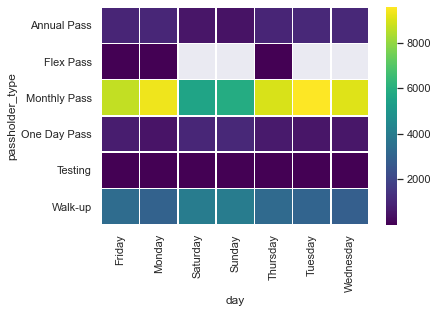

In [622]:
ax = sns.heatmap(heatpassholder, linewidths=.5, cmap = "viridis")  

#heatmap to show the number of journeys per passholder_type per day. 

#### Analysis

From the heatmap its safe to conclude that the monthly pass is the most used type of pass across all the days.
 The pass used the least was the flex pass which was not even used on some specific days. Action upon these results for the company could be to remove the flex pass overall as it is not making the company much money.


## Task 2 - Data Clustering - Seed shape data

In [623]:
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture as GMM

from sklearn.metrics import silhouette_score
from scipy.spatial.distance import cdist
from matplotlib.patches import Ellipse
from sklearn.metrics import confusion_matrix,classification_report
from sklearn.datasets import make_blobs
from scipy.spatial.distance import cdist

# importing all relevant libraries


In [624]:
import sys
seeds = pd.read_csv('~/Desktop/seeds.csv')

- The functions below are used to gather relevant information on the dataset, this allows us to see if there are any null values, missing points etc. Also, by visualising the data on plots it gives a better grasp on how the data points correspond to each other and their impacts on each other.

In [625]:
seeds.head()

,area,perimeter,compactness,length,width,asymmetry,groove length
0,15.26,14.84,0.871,5.763,3.312,2.221,5.220
1,14.88,14.57,0.881,5.554,3.333,1.018,4.956
2,14.29,14.09,0.905,5.291,3.337,2.699,4.825
3,13.84,13.94,0.895,5.324,3.379,2.259,4.805
4,16.14,14.99,0.903,5.658,3.562,1.355,5.175


In [626]:
df.tail()

,area,perimeter,compactness,length,width,asymmetry,groove length
205,12.19,13.20,0.878,5.137,2.981,3.631,4.870
206,11.23,12.88,0.851,5.140,2.795,4.325,5.003
207,13.20,13.66,0.888,5.236,3.232,8.315,5.056
208,11.84,13.21,0.852,5.175,2.836,3.598,5.044
209,12.30,13.34,0.868,5.243,2.974,5.637,5.063


In [627]:
seeds.shape

(210, 7)

In [628]:
seeds.dtypes

area             float64
perimeter        float64
compactness      float64
length           float64
width            float64
asymmetry        float64
groove length    float64
dtype: object

In [629]:
seeds.columns

Index(['area', 'perimeter', 'compactness', 'length', 'width', 'asymmetry',
       'groove length'],
      dtype='object')

In [630]:
seeds.isnull().sum()

area             0
perimeter        0
compactness      0
length           0
width            0
asymmetry        0
groove length    0
dtype: int64

In [631]:
seeds.describe()

,area,perimeter,compactness,length,width,asymmetry,groove length
count,210.000000,210.000000,210.000000,210.000000,210.000000,210.000000,210.000000
mean,14.847524,14.559286,0.871000,5.628533,3.258605,3.700200,5.408071
std,2.909699,1.305959,0.023594,0.443063,0.377714,1.503559,0.491480
min,10.590000,12.410000,0.808000,4.899000,2.630000,0.765000,4.519000
25%,12.270000,13.450000,0.857250,5.262250,2.944000,2.561500,5.045000
50%,14.355000,14.320000,0.873500,5.523500,3.237000,3.599000,5.223000
75%,17.305000,15.715000,0.887750,5.979750,3.561750,4.768750,5.877000
max,21.180000,17.250000,0.918000,6.675000,4.033000,8.456000,6.550000


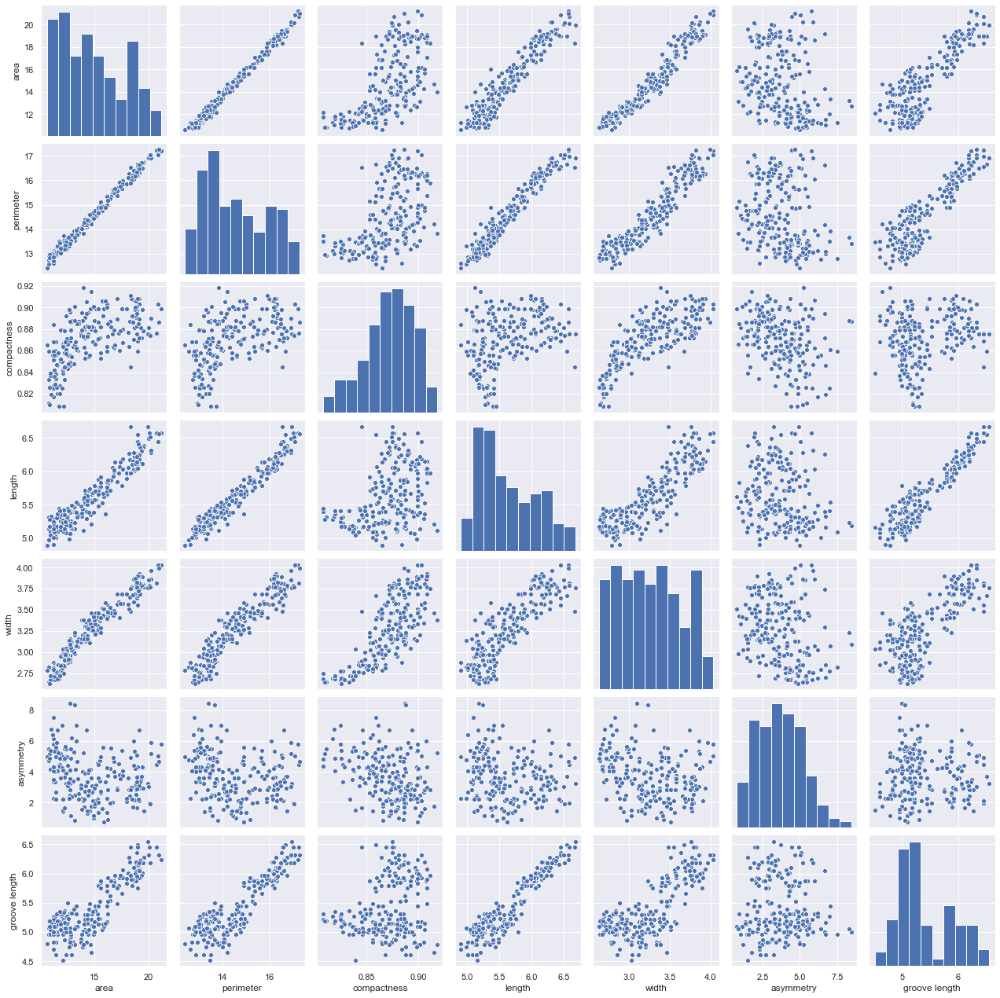

In [632]:
sns.pairplot(seeds)

*Fig 1*

**Clustering** 

In [766]:
#Creating a kmeans oobject
kmeans = KMeans(n_clusters = 4)

In [767]:
#kmeans object fitted to dataset
kmeans.fit(points)

KMeans(n_clusters=4)

In [768]:
y_kmeans

array([1, 1, 1, 2, 3, 3, 0, 0, 1, 2, 3, 1, 0, 0, 1, 0, 0, 0, 2, 2, 1, 3,
       1, 1, 0, 0, 1, 3, 3, 2, 2, 1, 3, 0, 1, 3, 2, 2, 1, 1, 3, 1, 3, 1,
       2, 0, 1, 3, 3, 2, 2, 3, 0, 0, 2, 2, 1, 0, 1, 1, 0, 2, 0, 3, 1, 2,
       2, 0, 2, 2, 0, 1, 2, 1, 1, 0, 0, 3, 2, 3, 1, 1, 0, 0, 0, 0, 2, 1,
       3, 3, 2, 3, 3, 3, 2, 1, 2, 3, 0, 0], dtype=int32)

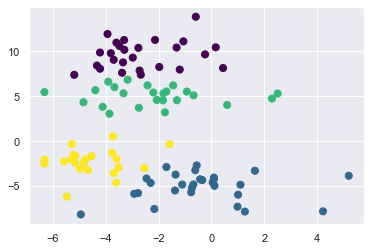

In [769]:
plt.scatter(points[:, 0], points[:, 1], c=y_kmeans, s=50, cmap='viridis')  

# Visualising the data on a plot to then allocate cluster centers.

*Fig 2*

In [762]:
centers = kmeans.cluster_centers_   

# identifying the cluster centers in the data and assigning it var name centers

In [763]:
# print out the clusters
print(centers)

[[-2.21257929  5.05552212]
 [-4.52443975 -2.29484816]
 [-2.64716763  9.63114522]
 [-0.40957985 -5.08099916]]


In [764]:
y_kmeans = kmeans.fit_predict(points)   

# function that predicts the of center points. 

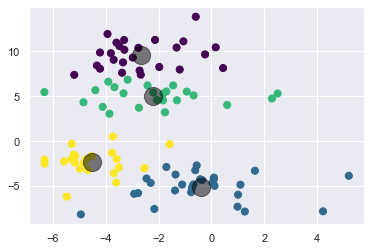

In [765]:
plt.scatter(points[:, 0], points[:, 1], c=y_kmeans, s=50, cmap='viridis')

plt.scatter(centers[:, 0], centers[:, 1], c='black', s=330, alpha=0.5);

# Plotting a scatter graph to visualise this, centers are indicated by the black circles.

*Fig 3*

In [770]:
def find_kmeans(kmeans, points, n_clusters=4, rseed=0, ax=None):
    labels = kmeans.fit_predict(points)

    # plot the input data
    ax = ax or plt.gca() 
    ax.set(xlim=(-10, 10), ylim=(-10, 15))
    ax.scatter(points[:, 0], points[:, 1], c=labels, s=50, cmap='viridis', zorder=2)

    # plot the representation of the KMeans model
    centers = kmeans.cluster_centers_
    radii = [cdist(points[labels == i], [center]).max()
             for i, center in enumerate(centers)]
    for c, r in zip(centers, radii):
        ax.add_patch(plt.Circle(c, r, fc='#CCCCCC', lw=3, alpha=0.5, zorder=1))

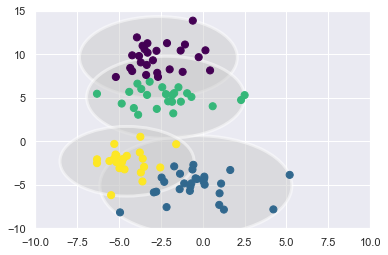

In [771]:
kmeans = KMeans(n_clusters=4, random_state=0)
find_kmeans(kmeans, points)


# identifying the clusters and then outlining them with the ovals as seen as below. Functions uses prediction 
# algorithm to analyse where centers are and datapoints around the cluster center. 

*Fig 4*

In [773]:
inertia = []       # Creating a list such that values can be stored when K varies
K  = range(1,5)   # param for k values identified can be varied. 
for k in K:
    km = KMeans(n_clusters=k)
    km = km.fit(points)
    inertia.append(km.inertia_)

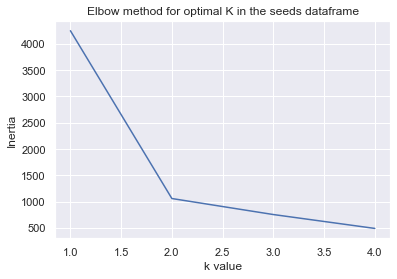

In [774]:
plt.plot(K, inertia)
plt.xlabel('k value')
plt.ylabel('Inertia')
plt.title('Elbow method for optimal K in the seeds dataframe')
plt.show()

# Using the std lib in matplotlib to plot graph showing elbow method presentation of optimal k value. 

*Fig 5*

In [776]:
s_score = []   # Creating a list such that values can be stored when K varies

#Range of the different values of K to analyse
K = range(2,10)
for k in K:
    kmeans = KMeans(n_clusters=k)
    kmeans.fit(seeds)
    s_score.append(silhouette_score(seeds[['area', 'perimeter', 'compactness', 'length', 'width', 'asymmetry',
       'groove length']], kmeans.labels_))

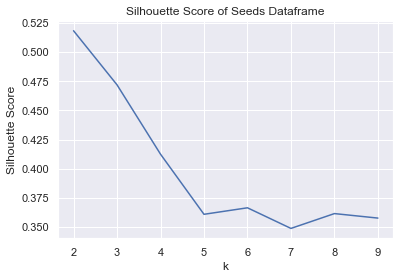

In [738]:
plt.plot(K, s_score)
plt.xlabel('k')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score of Seeds Dataframe')
plt.show()

#Plotting the values to show silhouette score of the dataset

*Fig 6*

**Analysis**

By looking at both the silhouette score (Fig 6) and the interia score of the dataframe, it is clear to see the relation of the instance to its cluster. From clusters 2-9 the instances get closer to the cluster boundary. This is clear from the visualisation above (Fig 4) with several points being close to or near the boundary. The optimal number for the k value is also evident from the graph with the dropoff being 4 (Fig 5).Overall, this Kmeans method shows what the optimal number of clusters looks like. 

## Task 3 - Social Network Analysis 

In [671]:
import networkx as nx

In [672]:
import os
cwd = os.getcwd()
print(cwd)

# Checking current working dir as file was not importing directly from desktop at first

/Users/yusuffazaldin


**General Info on the network**

In [673]:
Social = open('social-network.csv', "r")
next(Social, None)  # skip the first line in the input file, otherwise file was not recognising the values as int. 
Graphtype = nx.Graph()

g = nx.parse_edgelist(Social, delimiter=',', create_using=Graphtype,
                      nodetype=int, data=(('weight', float),))
G = g

#### Methods of the network  

In [674]:
g.nodes()

NodeView((1, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 2

In [675]:
g.edges()

EdgeView([(1, 3), (1, 4), (1, 5), (1, 6), (1, 7), (1, 8), (1, 9), (1, 10), (1, 11), (1, 12), (1, 13), (1, 14), (1, 15), (1, 16), (1, 17), (1, 18), (1, 19), (1, 20), (1, 21), (1, 22), (1, 23), (1, 24), (1, 25), (1, 26), (1, 27), (1, 28), (1, 29), (1, 30), (1, 31), (1, 32), (1, 33), (1, 34), (1, 35), (1, 36), (1, 37), (1, 38), (1, 39), (1, 40), (1, 41), (1, 42), (1, 43), (1, 44), (1, 45), (1, 46), (1, 47), (1, 48), (1, 49), (1, 50), (1, 51), (1, 52), (1, 53), (1, 54), (1, 55), (1, 56), (1, 57), (1, 58), (1, 59), (1, 60), (1, 61), (1, 62), (1, 63), (1, 64), (1, 65), (1, 66), (1, 67), (1, 68), (1, 69), (1, 70), (1, 71), (1, 72), (1, 73), (1, 74), (1, 75), (1, 76), (1, 77), (1, 78), (1, 79), (1, 80), (1, 81), (1, 82), (1, 83), (1, 84), (1, 85), (1, 86), (1, 87), (1, 88), (1, 89), (1, 90), (1, 91), (1, 92), (1, 93), (1, 94), (1, 95), (1, 96), (1, 97), (1, 98), (1, 99), (1, 100), (1, 101), (1, 102), (1, 103), (1, 104), (1, 105), (1, 106), (1, 107), (1, 108), (1, 109), (1, 110), (1, 111), (1, 

In [676]:
g.number_of_nodes(), g.number_of_edges()

(2887, 2980)

In [677]:
g.has_node(6)  # Node 6 returns true so it is a part of the network

True

In [678]:
edge1 = g.has_edge(342,42) # Edge 342,42 is not in the network 
edge2 = g.has_edge(1,42)   # Edge 1,42 is a part of the network
print(edge1,edge2)

False True


#### Properties of the network

In [679]:
nx.degree(g,6)

1

In [680]:
nx.number_connected_components(g)

1

In [681]:
nx.diameter(g)

9

In [796]:
nx.shortest_path(g) 

{1: {1: [1],
  3: [1, 3],
  4: [1, 4],
  5: [1, 5],
  6: [1, 6],
  7: [1, 7],
  8: [1, 8],
  9: [1, 9],
  10: [1, 10],
  11: [1, 11],
  12: [1, 12],
  13: [1, 13],
  14: [1, 14],
  15: [1, 15],
  16: [1, 16],
  17: [1, 17],
  18: [1, 18],
  19: [1, 19],
  20: [1, 20],
  21: [1, 21],
  22: [1, 22],
  23: [1, 23],
  24: [1, 24],
  25: [1, 25],
  26: [1, 26],
  27: [1, 27],
  28: [1, 28],
  29: [1, 29],
  30: [1, 30],
  31: [1, 31],
  32: [1, 32],
  33: [1, 33],
  34: [1, 34],
  35: [1, 35],
  36: [1, 36],
  37: [1, 37],
  38: [1, 38],
  39: [1, 39],
  40: [1, 40],
  41: [1, 41],
  42: [1, 42],
  43: [1, 43],
  44: [1, 44],
  45: [1, 45],
  46: [1, 46],
  47: [1, 47],
  48: [1, 48],
  49: [1, 49],
  50: [1, 50],
  51: [1, 51],
  52: [1, 52],
  53: [1, 53],
  54: [1, 54],
  55: [1, 55],
  56: [1, 56],
  57: [1, 57],
  58: [1, 58],
  59: [1, 59],
  60: [1, 60],
  61: [1, 61],
  62: [1, 62],
  63: [1, 63],
  64: [1, 64],
  65: [1, 65],
  66: [1, 66],
  67: [1, 67],
  68: [1, 68],
  69: [1, 6

In [686]:
degrees = []

for n in g.nodes():
    degrees.append(nx.degree(g,n))
degrees

[286,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 1,
 3,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 2,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 1,
 4,
 1,
 1,
 1,
 1

In [687]:
print(max(degrees))
print(min(degrees))

769
1


In [688]:
sum(degrees)/len(degrees )

2.064426740561136

#### Degree Distribution

In [777]:
nx.degree_histogram(g) 

# Shows the degree distribution of the dataset. 

[0,
 2789,
 82,
 3,
 3,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 1,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,
 0,


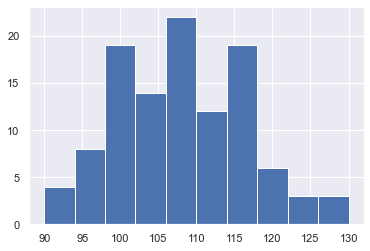

In [690]:
def plot_degree_dist(g):
    degrees = [g.degree(n) for n in g.nodes()]
    plt.hist(degrees)
    plt.show()

plot_degree_dist(nx.gnp_random_graph(110, 0.5, directed=True)) 

# a histogram showing the degree distribution of the nodes

*Fig 1*

Text(0, 0.5, 'Frequency')

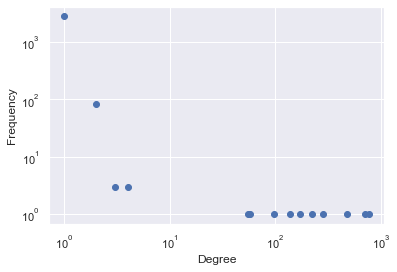

In [691]:
ddist = nx.degree_histogram(G)[1:] # Skip 0 degree nodes
plt.loglog(range(1,len(ddist)+1),ddist,'o') 
plt.xlabel("Degree")
plt.ylabel("Frequency")

*Fig 2*

#### Cluster Coefficient

In [692]:
cc = nx.clustering(g)
cc

{1: 2.45368666421298e-05,
 3: 0,
 4: 0,
 5: 0,
 6: 0,
 7: 0,
 8: 0,
 9: 0,
 10: 0,
 11: 0,
 12: 0,
 13: 0,
 14: 0,
 15: 0,
 16: 0,
 17: 0,
 18: 0,
 19: 0,
 20: 0,
 21: 0,
 22: 0,
 23: 0,
 24: 0,
 25: 0,
 26: 0,
 27: 0,
 28: 0,
 29: 0,
 30: 0,
 31: 0,
 32: 0,
 33: 0,
 34: 0,
 35: 0,
 36: 0,
 37: 0,
 38: 0,
 39: 0,
 40: 0,
 41: 0,
 42: 0,
 43: 0,
 44: 0,
 45: 0,
 46: 0,
 47: 0,
 48: 0,
 49: 0,
 50: 0,
 51: 0,
 52: 0,
 53: 0,
 54: 0,
 55: 0,
 56: 0,
 57: 0,
 58: 0,
 59: 0,
 60: 0,
 61: 0,
 62: 0,
 63: 0,
 64: 0,
 65: 0,
 66: 0,
 67: 0,
 68: 0,
 69: 0,
 70: 0,
 71: 0.3333333333333333,
 72: 0,
 73: 0,
 74: 0,
 75: 0,
 76: 0,
 77: 0,
 78: 0,
 79: 0,
 80: 0,
 81: 0,
 82: 0,
 83: 0,
 84: 0,
 85: 0,
 86: 0,
 87: 0,
 88: 0,
 89: 0,
 90: 0,
 91: 0,
 92: 0,
 93: 0,
 94: 0,
 95: 0,
 96: 0,
 97: 0,
 98: 0,
 99: 0,
 100: 0,
 101: 0,
 102: 0,
 103: 0,
 104: 0,
 105: 0,
 106: 0,
 107: 0,
 108: 0,
 109: 0,
 110: 0,
 111: 0,
 112: 0,
 113: 0,
 114: 0,
 115: 0,
 116: 0,
 117: 0,
 118: 0,
 119: 0,
 120: 0,

Text(0.5, 0, 'Clustering coefficient')

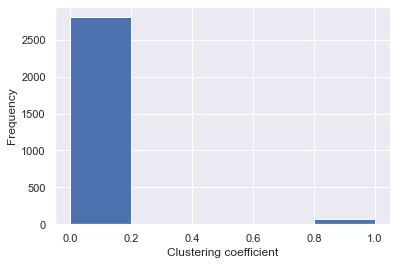

In [694]:
plt.hist(list(cc.values()),bins=5)
plt.ylabel("Frequency")
plt.xlabel("Clustering coefficient")

*Fig 3*

#### Betweeness Centrality

In [793]:
#nx.betweenness_centrality(g)  used to not lag out report but will run when # removed.

**Assortativity Coefficient**

In [779]:
nx.degree_assortativity_coefficient(g)

-0.6680321896944319

#### Visualising the network

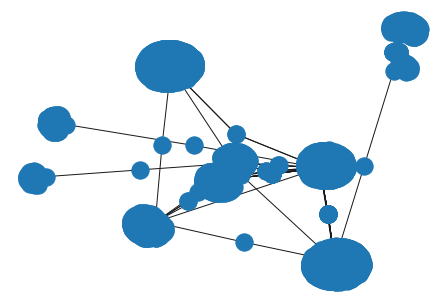

In [695]:
layout = nx.spring_layout(G)
nx.draw(G)

*Fig 4*

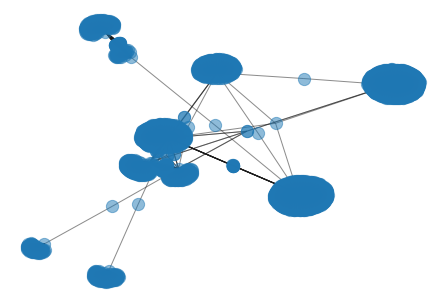

In [696]:
layout = nx.spring_layout(G)
nx.draw(G,pos=layout,node_size=150,alpha=0.5)

*Fig 5*

#### Random Graphs

- Experimentation with random graphs to test how topology varies with different value inputs.

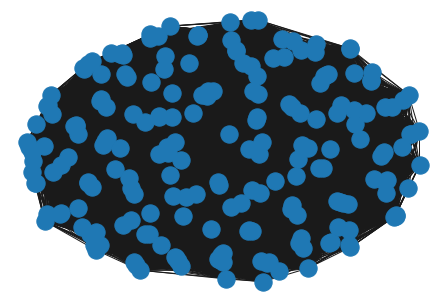

In [684]:
plt.clf()
rand = nx.fast_gnp_random_graph(212,242/10)
nx.draw(rand)

*Fig 6*

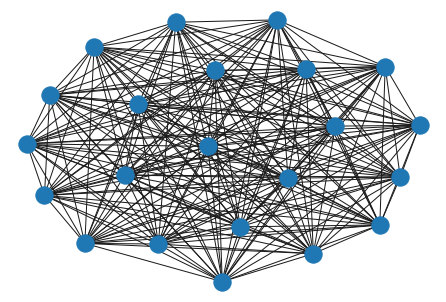

In [683]:
plt.clf()
rand = nx.fast_gnp_random_graph(22,43/12)
nx.draw(rand)

*Fig 7*

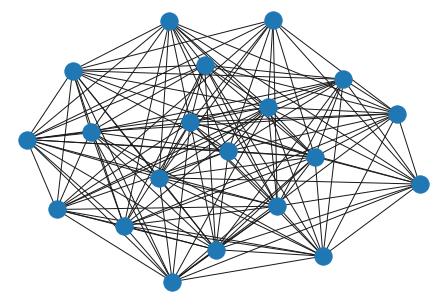

In [789]:
plt.clf()
rand = nx.fast_gnp_random_graph(20,0.4/0.5)
nx.draw(rand)

*Fig 8*

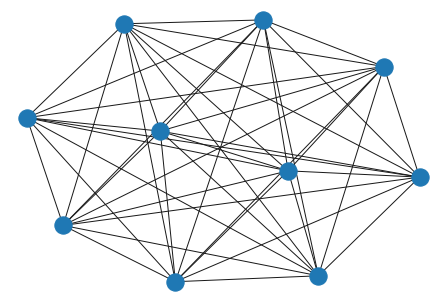

In [715]:
plt.clf()
rand = nx.fast_gnp_random_graph(10,10/10)
nx.draw(rand)

*Fig 9*

**Analysis**

Overall, the the dataset has a high betweeness centrality which means that the seperate reigons in the network are
more connected which is better for the network. Furthermore, the assortativity coefficient is low which means the
nodes have a negative assortativity. The node systems in this network form more of a mesh topology network.This is done through the forced direct layout approach where the overall force to a node is applied and calculated so it can be moved.(Fig 6,7,8,9) This is beneficial as they are more reliable and stable, furthermore as the nodes in this network are more interconnected makes it more resistant to faiure.However, with these type of networks there are some disadvantages, one being that the standard toplogy is extremely hard to maintain.
